In [4]:
import pandas as pd
import matplotlib.pyplot as plt

# load the training dataset
water_data = pd.read_csv('2020-ph.csv')
water_data.drop(['clUnit', 'tbUnit','fcltyAddr', 'fcltyMngNm', 'occrrncDt','phUnit','liIndDivName'], axis=1, inplace=True)

water_data.head()

,clVal,fcltyMngNo,phVal,tbVal
0,0.8624,4127112311,7.5653,0.0712
1,0.8498,4127112311,7.5546,0.0713
2,0.8161,4127112311,7.5437,0.0718
3,0.7869,4127112311,7.5354,0.0722
4,0.747,4127112311,7.528,0.072


In [5]:
water_data.info()

water_data = water_data[water_data.clVal != '점검중']
water_data = water_data[water_data.clVal != '0']
water_data = water_data[water_data.clVal != '1,264.84']
water_data = water_data[water_data.phVal != '점검중']
water_data = water_data[water_data.phVal != '0']
water_data = water_data[water_data.tbVal != '점검중']
water_data = water_data[water_data.tbVal != '0']

water_data

water_data['clVal'] = water_data['clVal'].astype(float)
water_data['phVal'] = water_data['phVal'].astype(float)
water_data['tbVal'] = water_data['tbVal'].astype(float)
water_data['fcltyMngNo'] = water_data['fcltyMngNo'].astype(float)

water_data = water_data[water_data.clVal > 0]
water_data = water_data[water_data.tbVal > 0]
water_data = water_data[water_data.phVal > 0]

water_data.info()

water_data.rename(columns={'clVal':'cl', 'fcltyMngNo':'placeNo', 'phVal':'ph', 'tbVal':"tb" }, inplace=True)



water_data


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79712 entries, 0 to 79711
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   clVal       79712 non-null  object
 1   fcltyMngNo  79712 non-null  int64 
 2   phVal       79712 non-null  object
 3   tbVal       79712 non-null  object
dtypes: int64(1), object(3)
memory usage: 2.4+ MB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 66078 entries, 0 to 79711
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   clVal       66078 non-null  float64
 1   fcltyMngNo  66078 non-null  float64
 2   phVal       66078 non-null  float64
 3   tbVal       66078 non-null  float64
dtypes: float64(4)
memory usage: 2.5 MB


,cl,placeNo,ph,tb
0,0.8624,4.127112e+09,7.5653,0.0712
1,0.8498,4.127112e+09,7.5546,0.0713
2,0.8161,4.127112e+09,7.5437,0.0718
3,0.7869,4.127112e+09,7.5354,0.0722
4,0.7470,4.127112e+09,7.5280,0.0720
...,...,...,...,...
79707,0.5927,4.128512e+09,7.3668,0.0645
79708,0.5956,4.128512e+09,7.3664,0.0640
79709,0.6036,4.128512e+09,7.3655,0.0633
79710,0.6138,4.128512e+09,7.3649,0.0630


In [6]:
numeric_features = ['cl','ph','tb']
# water_data[numeric_features].describe()
water_data.loc[:, numeric_features].describe()

,cl,ph,tb
count,66078.000000,66078.000000,66078.000000
mean,0.807643,7.315627,0.055586
std,0.109535,0.255005,0.015922
min,0.000100,1.978700,0.002300
25%,0.723200,7.135100,0.044500
50%,0.807900,7.305100,0.056000
75%,0.884900,7.467000,0.067100
max,1.587500,8.228800,0.814200


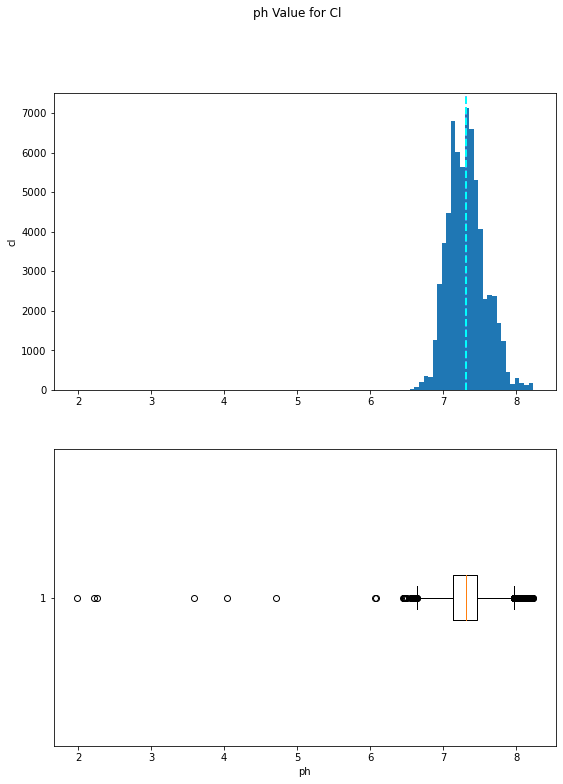

In [7]:
import pandas as pd
import matplotlib.pyplot as plt

# This ensures plots are displayed inline in the Jupyter notebook
%matplotlib inline

# Get the label column
label = water_data['ph']


# Create a figure for 2 subplots (2 rows, 1 column)
fig, ax = plt.subplots(2, 1, figsize = (9,12))

# Plot the histogram   
ax[0].hist(label, bins=100)
ax[0].set_ylabel('cl')

# Add lines for the mean, median, and mode
ax[0].axvline(label.mean(), color='magenta', linestyle='dashed', linewidth=2)
ax[0].axvline(label.median(), color='cyan', linestyle='dashed', linewidth=2)

# Plot the boxplot   
ax[1].boxplot(label, vert=False)
ax[1].set_xlabel('ph')

# Add a title to the Figure
fig.suptitle('ph Value for Cl')

# Show the figure
fig.show()


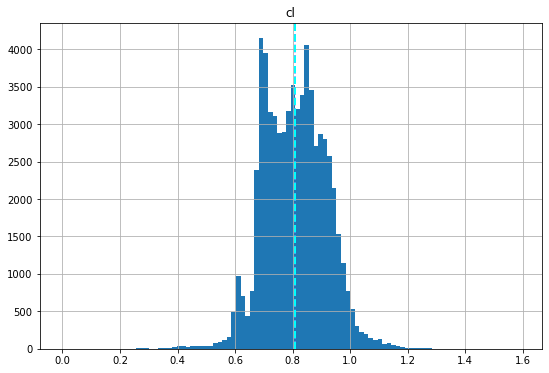

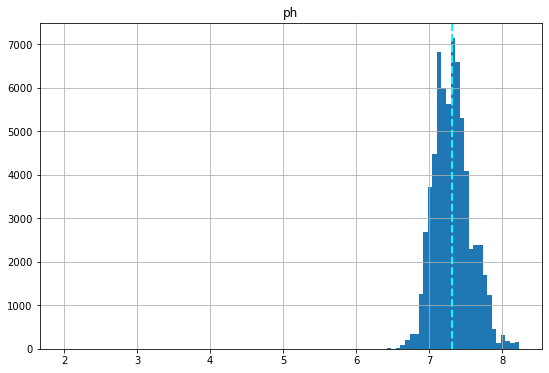

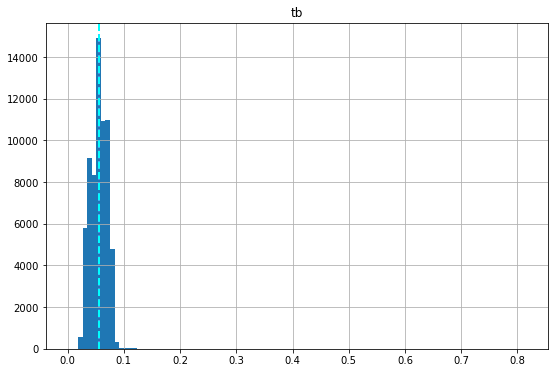

In [8]:
# Plot a histogram for each numeric feature
for col in numeric_features:
    fig = plt.figure(figsize=(9, 6))
    ax = fig.gca()
    feature = water_data[col]
    feature.hist(bins=100, ax = ax)
    ax.axvline(feature.mean(), color='magenta', linestyle='dashed', linewidth=2)
    ax.axvline(feature.median(), color='cyan', linestyle='dashed', linewidth=2)
    ax.set_title(col)
plt.show()

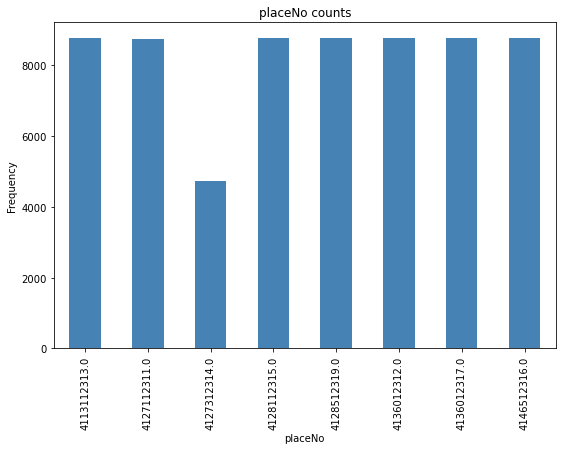

In [9]:
import numpy as np

# plot a bar plot for each categorical feature count
categorical_features = ['placeNo']

for col in categorical_features:
    counts = water_data[col].value_counts().sort_index()
    fig = plt.figure(figsize=(9, 6))
    ax = fig.gca()
    counts.plot.bar(ax = ax, color='steelblue')
    ax.set_title(col + ' counts')
    ax.set_xlabel(col) 
    ax.set_ylabel("Frequency")
plt.show()


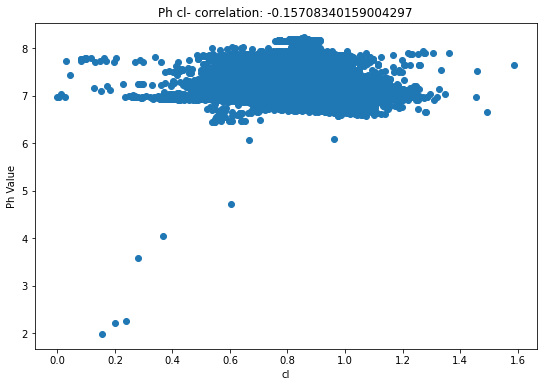

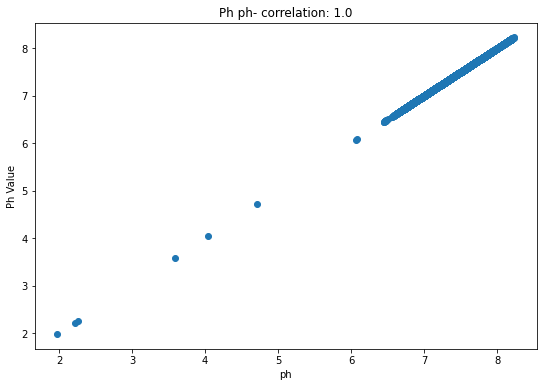

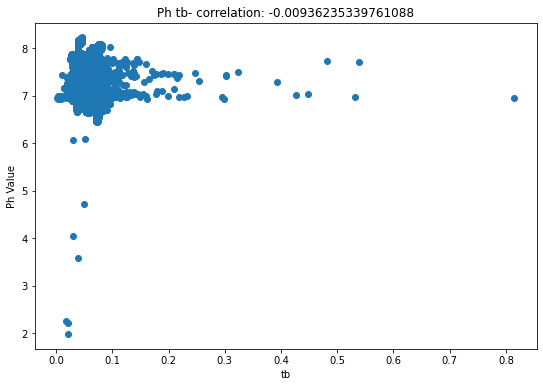

In [10]:
for col in numeric_features:
    fig = plt.figure(figsize=(9, 6))
    ax = fig.gca()
    feature = water_data[col]
    label = water_data['ph']
    correlation = feature.corr(label)
    plt.scatter(x=feature, y=label)
    plt.xlabel(col)
    plt.ylabel('Ph Value')
    ax.set_title('Ph ' + col + '- correlation: ' + str(correlation))
plt.show()


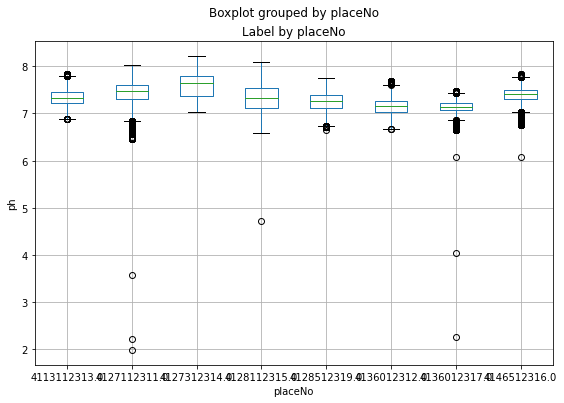

In [11]:
# plot a boxplot for the label by each categorical feature
for col in categorical_features:
    fig = plt.figure(figsize=(9, 6))
    ax = fig.gca()
    water_data.boxplot(column = 'ph', by = col, ax = ax)
    ax.set_title('Label by ' + col)
    ax.set_ylabel("ph")
plt.show()

In [12]:
# Separate features and labels
X, y = water_data[['cl','tb','placeNo']].values, water_data['ph'].values
print('Features:',X[:10], '\nLabels:', y[:10], sep='\n')

Features:
[[8.62400000e-01 7.12000000e-02 4.12711231e+09]
 [8.49800000e-01 7.13000000e-02 4.12711231e+09]
 [8.16100000e-01 7.18000000e-02 4.12711231e+09]
 [7.86900000e-01 7.22000000e-02 4.12711231e+09]
 [7.47000000e-01 7.20000000e-02 4.12711231e+09]
 [6.97900000e-01 7.23000000e-02 4.12711231e+09]
 [6.91800000e-01 7.23000000e-02 4.12711231e+09]
 [6.96800000e-01 7.24000000e-02 4.12711231e+09]
 [7.11100000e-01 7.22000000e-02 4.12711231e+09]
 [7.40000000e-01 7.22000000e-02 4.12711231e+09]]

Labels:
[7.5653 7.5546 7.5437 7.5354 7.528  7.5255 7.5301 7.5379 7.5485 7.5586]


In [13]:
from sklearn.model_selection import train_test_split

# Split data 70%-30% into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=0)

print ('Training Set: %d rows\nTest Set: %d rows' % (X_train.shape[0], X_test.shape[0]))

Training Set: 46254 rows
Test Set: 19824 rows


In [14]:
# Train the model
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression
import numpy as np

# Define preprocessing for numeric columns (scale them)
numeric_features = [0,1]
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())])

#Define preprocessing for categorical features (encode them)
categorical_features = [2]
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

#Combine preprocessing steps
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)])


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  [0, 1]),
                                                 ('cat',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  [2])])),
                ('regressor', RandomForestRegressor())]) 

MSE: 0.02738045114973186
RMSE: 0.16547039357459647
R2: 0.5794924722507033


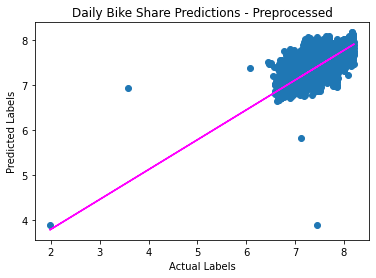

In [16]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Use a different estimator in the pipeline
pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                           ('regressor', RandomForestRegressor())])


# fit the pipeline to train a linear regression model on the training set
model = pipeline.fit(X_train, (y_train))
print (model, "\n")

# Get predictions
predictions = model.predict(X_test)

# Display metrics
mse = mean_squared_error(y_test, predictions)
print("MSE:", mse)
rmse = np.sqrt(mse)
print("RMSE:", rmse)
r2 = r2_score(y_test, predictions)
print("R2:", r2)

# Plot predicted vs actual
plt.scatter(y_test, predictions)
plt.xlabel('Actual Labels')
plt.ylabel('Predicted Labels')
plt.title('Daily Bike Share Predictions - Preprocessed')
z = np.polyfit(y_test, predictions, 1)
p = np.poly1d(z)
plt.plot(y_test,p(y_test), color='magenta')
plt.show()

In [66]:
import joblib

# Save the model as a pickle file
filename = './water_test5'
joblib.dump(model, filename)

['./water_test5']

In [18]:
import joblib
import numpy as np

# Load the model from the file
loaded_model = joblib.load('./water_test5')

# Create a numpy array containing a new observation (for example tomorrow's seasonal and weather forecast information)
X_new = np.array([[0,0,4113112313]])
#.astype('float64')
# print ('New sample: {}'.format(list(X_new[0])))

# Use the model to predict tomorrow's rentals
result = loaded_model.predict(X_new)
print('Prediction: {0} Ph'.format(np.round(result[0], 3)))

Prediction: 7.414 Ph
